# Based on [this](https://colab.research.google.com/drive/16jcaJoc6bCFAQ96jDe2HwtXj7BMD_-m5) Detectron 2 Tutorial from Facebook

# Detectron2 Beginner's Tutorial

<img src="https://dl.fbaipublicfiles.com/detectron2/Detectron2-Logo-Horz.png" width="500">

Welcome to detectron2! This is the official colab tutorial of detectron2. Here, we will go through some basics usage of detectron2, including the following:
* Run inference on images or videos, with an existing detectron2 model
* Train a detectron2 model on a new dataset

You can make a copy of this tutorial by "File -> Open in playground mode" and make changes there. __DO NOT__ request access to this tutorial.


# Install detectron2

In [1]:
!pip install pyyaml==5.1

import torch

TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]

print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)

# Install detectron2 that matches the above pytorch version
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions

!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/$CUDA_VERSION/torch$TORCH_VERSION/index.html

# If there is not yet a detectron2 release that matches the given torch + CUDA version, you need to install a different pytorch.

# exit(0)  # After installation, you may need to "restart runtime" in Colab. This line can also restart runtime

     |████████████████████████████████| 274 kB 5.3 MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44092 sha256=d3e8e00ec541b2627eb6b822a94ffef82b9af60f82ce35c5603ace85269a12be
  Stored in directory: /root/.cache/pip/wheels/77/f5/10/d00a2bd30928b972790053b5de0c703ca87324f3fead0f2fd9
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
torch:  1.10 ; cuda:  cu111
Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu111/torch1.10/index.html
     |████████████████████████████████| 7.0 MB 768 kB/s 
     |████████████████████████████████| 74 kB 2.3 MB/s 
     |████████████████████████████████| 49 kB 5.3 MB/s 
     |████████████████████████████████| 145 kB 11.2 MB/s 
     |████████████████████████████████| 130 kB 46.6 MB/s 
     |████████████████████████████████| 749 kB 39.4 MB/s 
     |███████████████████████████████

In [2]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random, tqdm
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

# Train on a custom dataset

In this section, we show how to train an existing detectron2 model on a custom dataset in a new format.

## Prepare the dataset

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
!ls 'drive/MyDrive/Colab Notebooks/CVDL/Assignment 2/'

'CVDL HW2 Mask R-CNN.ipynb'   data_masked.tar   roboflow_api_key.txt
'CVDL HW2 YOLOv4.ipynb'       data.tar
'CVDL HW2 YOLOv5.ipynb'       data.test


In [5]:
!tar -xvf 'drive/MyDrive/Colab Notebooks/CVDL/Assignment 2/data_masked.tar'

Mask R-CNN Aug (with train-val tags)/
Mask R-CNN Aug (with train-val tags)/dell/
Mask R-CNN Aug (with train-val tags)/dell/ann/
Mask R-CNN Aug (with train-val tags)/dell/ann/1.jpg.json
Mask R-CNN Aug (with train-val tags)/dell/ann/10.jpg.json
Mask R-CNN Aug (with train-val tags)/dell/ann/10_LR7DQIAg5r.jpg.json
Mask R-CNN Aug (with train-val tags)/dell/ann/10_XgvoXAaXx8.jpg.json
Mask R-CNN Aug (with train-val tags)/dell/ann/10_s46hhB9rND.jpg.json
Mask R-CNN Aug (with train-val tags)/dell/ann/10_wLPeeXr2gP.jpg.json
Mask R-CNN Aug (with train-val tags)/dell/ann/10_xvDgclOt1y.jpg.json
Mask R-CNN Aug (with train-val tags)/dell/ann/11.jpg.json
Mask R-CNN Aug (with train-val tags)/dell/ann/11_LSG4k1VzB2.jpg.json
Mask R-CNN Aug (with train-val tags)/dell/ann/11_Sr0lAbnPgN.jpg.json
Mask R-CNN Aug (with train-val tags)/dell/ann/11_cDhYAM4DYH.jpg.json
Mask R-CNN Aug (with train-val tags)/dell/ann/11_giGVKsVXMJ.jpg.json
Mask R-CNN Aug (with train-val tags)/dell/ann/11_yoPYVOXkWU.jpg.json
Mask R-CN

Register the dataset to detectron2, following the [detectron2 custom dataset tutorial](https://detectron2.readthedocs.io/tutorials/datasets.html).
Here, the dataset is in its custom format, therefore we write a function to parse it and prepare it for detectron2's standard format. User should write such a function when using a dataset in custom format. See the tutorial for more details.


In [63]:
from detectron2.structures import BoxMode

dataset_path = 'Mask R-CNN Aug (with train-val tags)'

def get_laptops_dicts(img_dir, mode_tag):
    dell_path = os.path.join(img_dir, 'dell')
    macbook_path = os.path.join(img_dir, 'macbook')

    annotations = []

    for path in [dell_path, macbook_path]:
        for json_filename in os.listdir(os.path.join(path, 'ann')):
            with open(os.path.join(path, 'ann', json_filename)) as f:
                image_annotation = json.load(f)

            image_filename = os.path.join(path, 'img', json_filename[:-5])
            annotations.append((image_filename, image_annotation))

    train_dicts = []
    val_dicts = []
    for idx, (filename, v) in enumerate(annotations):
        record = dict()
        
        # print(filename, v)

        height, width = cv2.imread(filename).shape[:2]
        size = v['size']
        height, width = size['height'], size['width']
        
        record["file_name"] = filename
        record["image_id"] = idx
        record["height"] = height
        record["width"] = width

        label = v['objects'][0]['classTitle']
        if label == 'DELL':
            label = 0
        elif label == 'MacBook':
            label = 1

        points = v['objects'][0]['points']['exterior']
        
        pxs, pys = [p[0] for p in points], [p[1] for p in points]
        
        poly = [(x + 0.5, y + 0.5) for x, y in zip(pxs, pys)]

        obj = {
            "bbox": [np.min(pxs), np.min(pys), np.max(pxs), np.max(pys)],
            "bbox_mode": BoxMode.XYXY_ABS,
            "segmentation": [poly],
            "category_id": label,
        }
        record["annotations"] = [obj]
        
        tag = v['tags'][0]['name']
        if tag == mode_tag == 'train':
            train_dicts.append(record)
        elif tag == mode_tag == 'val':
            val_dicts.append(record)
    
    if mode_tag == 'train':
        return train_dicts
    
    if mode_tag == 'val':
        return val_dicts

In [64]:
DatasetCatalog.clear()
MetadataCatalog.clear()

DatasetCatalog.list(), MetadataCatalog.list()

([], [])

In [65]:
for d in ["train", "val"]:
    DatasetCatalog.register("laptops_" + d, lambda d=d: get_laptops_dicts(dataset_path, d))
    MetadataCatalog.get("laptops_" + d).set(thing_classes=["DELL", "MacBook"])

laptops_metadata = MetadataCatalog.get("laptops_train")

To verify the data loading is correct, let's visualize the annotations of randomly selected samples in the training set:



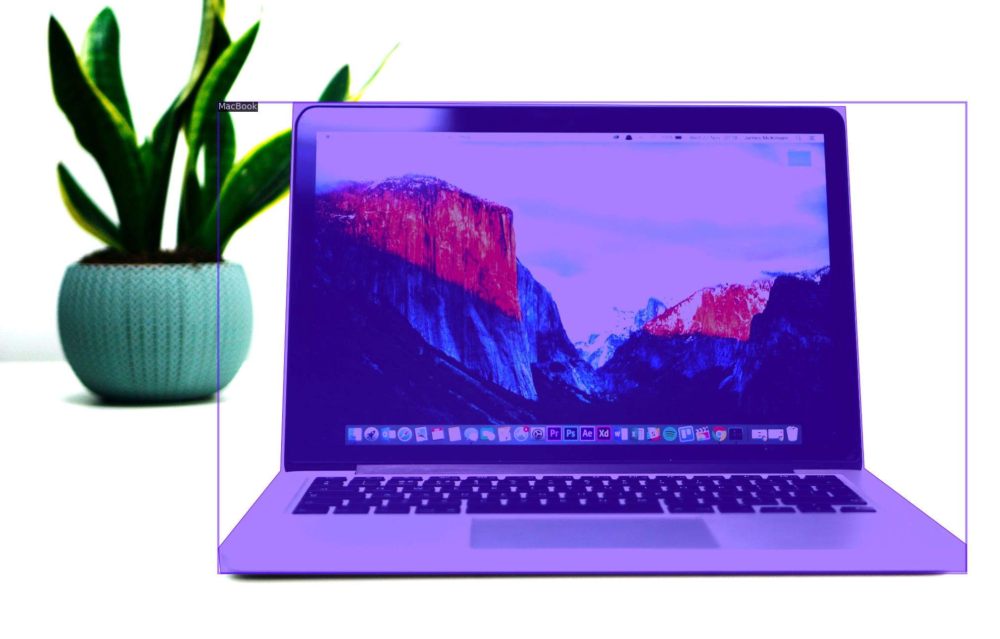

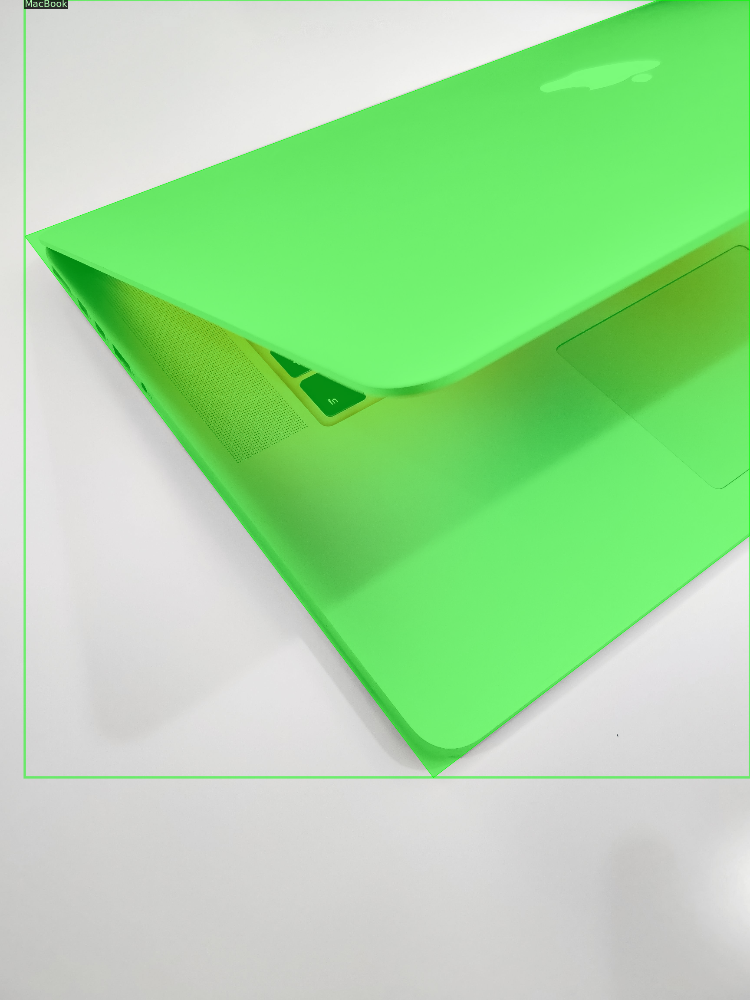

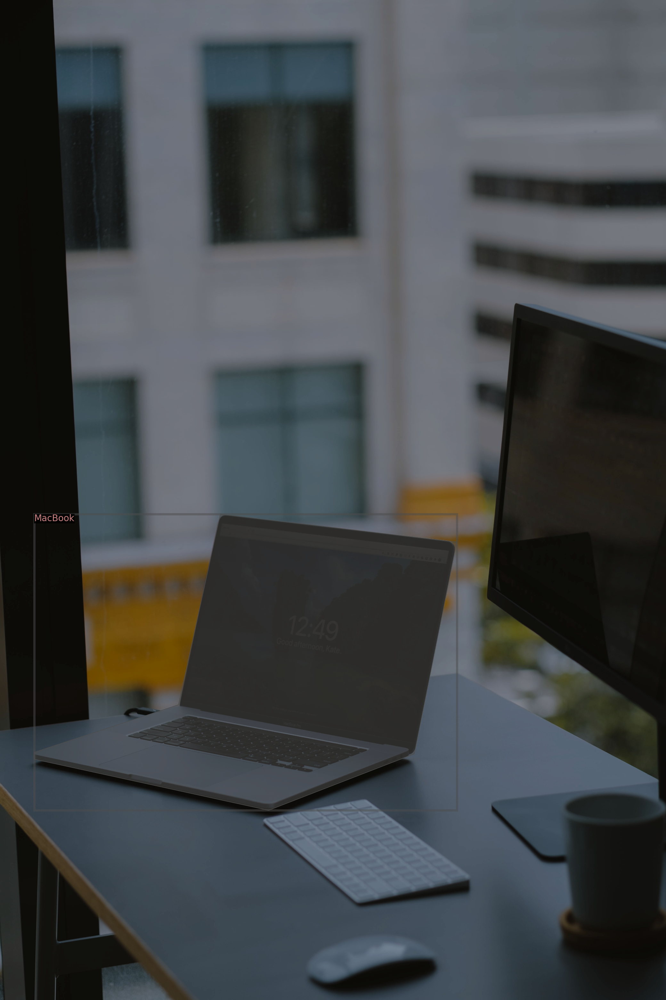

In [66]:
dataset_dicts = get_laptops_dicts(dataset_path, 'train')

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=laptops_metadata, scale=0.5)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

## Train!

Now, let's fine-tune a COCO-pretrained R50-FPN Mask R-CNN model on the dataset. It takes ~2 minutes to train 300 iterations on a P100 GPU.


In [67]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("laptops_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
cfg.SOLVER.MAX_ITER = 300    # 300 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2  # (see https://detectron2.readthedocs.io/tutorials/datasets.html#update-the-config-for-new-datasets)
# NOTE: this config means the number of classes, but a few popular unofficial tutorials incorrect uses num_classes+1 here.

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[12/03 23:13:25 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f10217.pkl: 178MB [00:06, 27.9MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (3, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (3,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (8, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (8,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to i

[12/03 23:15:53 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride
/usr/local/lib/python3.7/dist-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[12/03 23:16:33 d2.utils.events]:  eta: 0:07:41  iter: 19  total_loss: 2.366  loss_cls: 1.131  loss_box_reg: 0.5305  loss_mask: 0.6874  loss_rpn_cls: 0.007949  loss_rpn_loc: 0.003991  time: 1.8644  data_time: 0.6440  lr: 1.6068e-05  max_mem: 2670M
[12/03 23:17:14 d2.utils.events]:  eta: 0:07:47  iter: 39  total_loss: 2.079  loss_cls: 0.8673  loss_box_reg: 0.5415  loss_mask: 0.656  loss_rpn_cls: 0.008968  loss_rpn_loc: 0.004817  time: 1.9527  data_time: 0.7328  lr: 3.2718e-05  max_mem: 2762M
[12/03 23:17:54 d2.utils.events]:  eta: 0:07:11  iter: 59  total_loss: 1.67  loss_cls: 0.5497  loss_box_reg: 0.5309  loss_mask: 0.5849  loss_rpn_cls: 0.004915  loss_rpn_loc: 0.004037  time: 1.9663  data_time: 0.6246  lr: 4.9367e-05  max_mem: 2762M
[12/03 23:18:33 d2.utils.events]:  eta: 0:06:39  iter: 79  total_loss: 1.508  loss_cls: 0.4363  loss_box_reg: 0.5391  loss_mask: 0.5222  loss_rpn_cls: 0.004878  loss_rpn_loc: 0.003506  time: 1.9692  data_time: 0.6464  lr: 6.6017e-05  max_mem: 2762M
[12/03 

In [68]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

## Inference & evaluation using the trained model
Now, let's run inference with the trained model on the validation dataset. First, let's create a predictor using the model we just trained:



In [69]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

Then, we randomly select several samples to visualize the prediction results.

/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


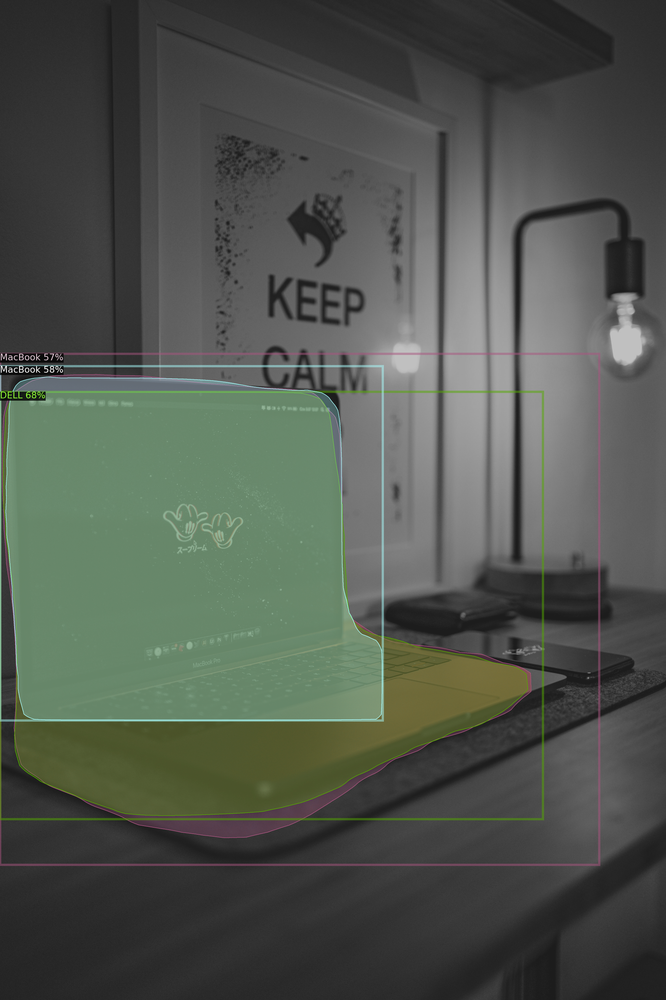

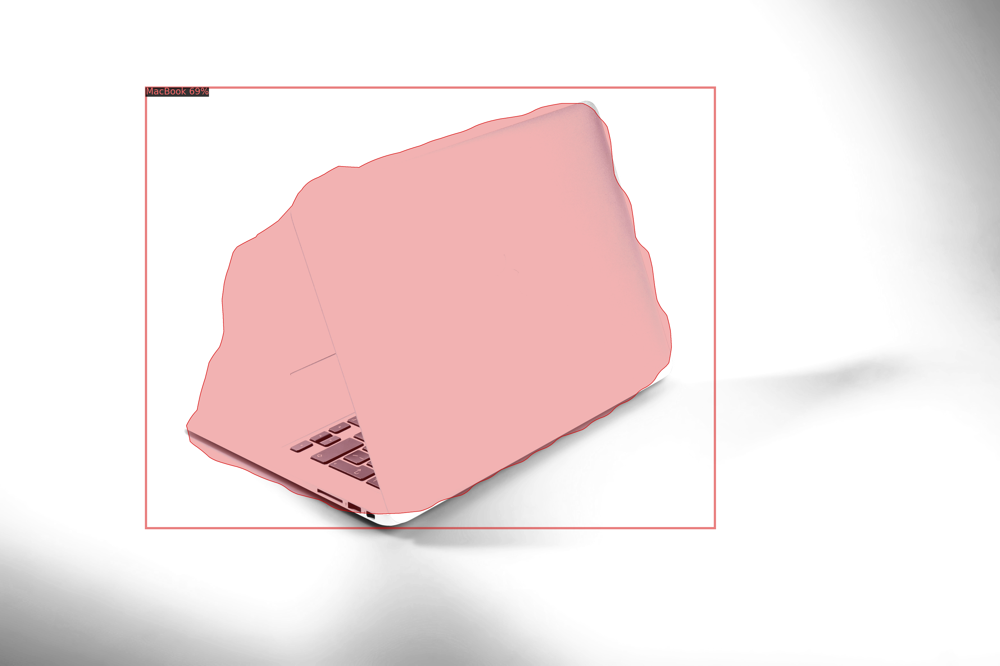

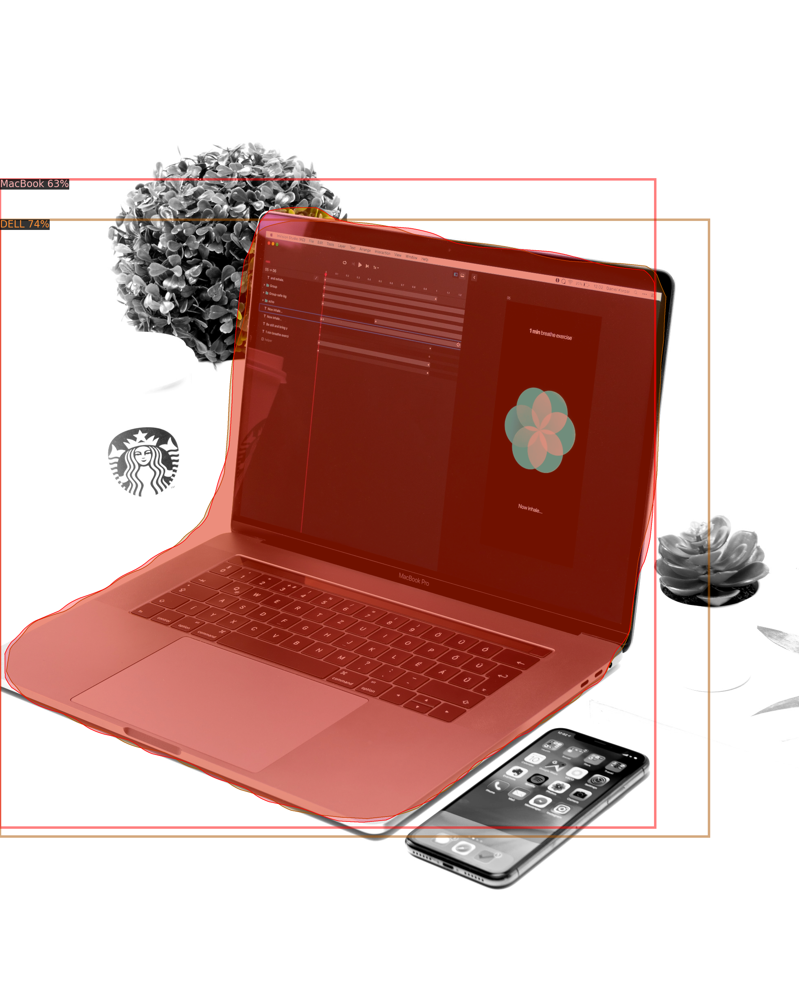

In [70]:
from detectron2.utils.visualizer import ColorMode

dataset_dicts = get_laptops_dicts(dataset_path, 'val')

for d in random.sample(dataset_dicts, 3):
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=laptops_metadata, 
                   scale=0.5, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])